# Difftraj with map matching

In [3]:
!pip show triton

Name: triton
Version: 3.2.0
Summary: A language and compiler for custom Deep Learning operations
Home-page: https://github.com/triton-lang/triton/
Author: Philippe Tillet
Author-email: phil@openai.com
License: 
Location: E:\Busbus\env\Lib\site-packages
Requires: 
Required-by: 


## Preproccess data

In [1]:
import os
import pickle
import datetime
import h5py
import numpy as np
import pandas as pd
import torch
import requests
import matplotlib.pyplot as plt

from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm
from torch.utils.data import TensorDataset, DataLoader
from pathlib import Path
from datetime import timedelta, datetime
from itertools import repeat

# Local imports
from project_code.utils import resample_trajectory

# TODO: move this to external config file
DATA_PATH_PREFIX = Path('data')
PREPROCESSED_DATA_PATH = DATA_PATH_PREFIX / 'bus_data_processed.pkl'
DATA_PATH=[ 
    'data_369.pkl',
    'data_370.pkl',
    'data_371.pkl',
    'data_372.pkl',
    'data_373.pkl',
    'data_375.pkl',
    'data_376.pkl',
    'data_377.pkl',
    'data_378.pkl',
    'data_379.pkl',
    'data_380.pkl',
    'data_381.pkl',
    'data_382.pkl',
    'data_383.pkl',
    'data_452.pkl',
    'data_452.pkl',
    'data_453.pkl',
    'data_454.pkl',
    'data_455.pkl',
] # Path to the input data
DATA_PATH = [DATA_PATH_PREFIX/'4_years'/path for path in DATA_PATH]

In [2]:
def check_fuelrate_NaNs():
    DATA_PATH_PREFIX = Path('./data')
    test = DATA_PATH_PREFIX / '4_years' / 'data_369.pkl'
    herp = pd.read_pickle(test)
    return herp.loc[herp.FuelRate.isna()].index.diff().value_counts() # Fuel missing for full trips. use constant fill + condition model
check_fuelrate_NaNs()

1.0       2515016
2.0          2442
3.0           766
4.0           755
299.0         568
           ...   
3177.0          1
2374.0          1
1965.0          1
2694.0          1
3053.0          1
Name: count, Length: 2591, dtype: int64

In [57]:
import pandas as pd
from haversine import haversine_vector

def timestamps2datetimes(timestamps):
    ref_timestamp = datetime.fromisoformat("2011-06-16T05:23:00").timestamp()
    datetimes = (np.array(timestamps)/1000+ref_timestamp).astype("datetime64[s]")
    return datetimes

def add_datetime_column(df):
    assert 'timestamps' in df.columns
    ref_timestamp = datetime.fromisoformat("2011-06-16T05:23:00").timestamp()
    datetimes = (df.timestamps/1000+ref_timestamp).astype("datetime64[s]")
    df.loc[:, 'datetime'] = pd.Series(datetimes, index=df.index, name='datetime')
    return df

def add_speed_column(df, sample_rate:float=2.0):
    'Uses haversine to estimate the speed. This operation is inplace'
    speed = df.loc[:,['lat','lon']]
    speed = map(haversine_vector, speed.shift(1).bfill().to_numpy(), speed.to_numpy()) # km
    speed = map(lambda x:x[0], speed)
    speed = pd.Series(speed, index=df.index, name='speed')*1000 / sample_rate # m/s
    df.loc[:,'speed'] = speed
    return df

def read_h5(path:str) -> 'pandas.DataFrame':
    with h5py.File(path, "r") as f:
        bus_dfs = []
        for bus_name in f.keys():
            bus_data = f[bus_name]
            columns = {
                "timestamp":bus_data["timestamps"],
                "lat":np.degrees(bus_data["GPS0"]),
                "lon":np.degrees(bus_data["GPS1"]),
            }
            df = pd.DataFrame(columns)
            
            bus_dfs.append(df)        
        return pd.concat(bus_dfs, ignore_index=True)

def read_panda_pkl(path:str) -> 'pd.DataFrame':
    df = pd.read_pickle(path)
    name_fix={'lat':'lon','lon':'lat'}
    df.rename(columns=name_fix, inplace=True)
    return df.loc[:,['datetime','lat','lon','FuelRate']]

def open_data(paths:list[str]) -> 'pd.DataFrame':
    "Maps file extention to loader and calls it"
    ext2loader = {
        '.pickle':lambda p: pickle.load(open(p,'rb')),
        '.pkl':read_panda_pkl,
        '.csv':pd.read_csv,
    }
    dfs = []
    for path in paths:
        _, extention = os.path.splitext(path)
        df = ext2loader[extention](path)
        dfs.append(df)
    return pd.concat(dfs, ignore_index=True)

def plot_on_map(*dfs, name=None):
    import plotly.express as px
    dfs = [df.assign(trip=[i]*len(df)) for i, df in enumerate(dfs)]
    df = pd.concat(dfs, axis=0)
    fig = px.line_map(df, lat='lat', lon='lon', color='trip', hover_data='speed', zoom=12, height=600)
    fig.update_layout(map_style='open-street-map', margin={v:0 for v in 'rtlb'}, showlegend=False)
    if name:
        plt.savefig(name+'.png');
    fig.show();

def linear_interpolation(start:float, end:float, steps:int=1) -> list:
    'Interpolates new values between start and end'
    step_size = (end - start) / (steps + 1)
    return [start + i * step_size for i in range(1, steps + 1)]
    
def interpolate_indices(indices:list[int], max_length:int=200) -> list: 
    'Interpolates new indices where the gap greater than max_length, indices must be sorted in ascending order'
    interpolated_indices = []
    for start_index, end_index in zip(indices, indices[1:]):
        interpolated_indices.append(start_index)
        span = end_index - start_index
        if span > max_length:
            new_values = linear_interpolation(start_index, end_index, steps=span//max_length)
            interpolated_indices += [*map(int, new_values)]

    interpolated_indices.append(indices[-1])
    return interpolated_indices

def bin_embedding(list_of_trips, bins=[16,16]):
    """
    Builds uni-spaced embedding ids in space. 
    Note, outliers mess with the bin sizes. 
    Also accepts bins as input for inference purposes.
    """
    x_bins, y_bins = bins
    d = list_of_trips # shorten name
    x_corr = np.array([d[i].iloc[[0,-1]]['lat'] for i in range(len(d))]).ravel() # start and end x
    y_corr = np.array([d[i].iloc[[0,-1]]['lon'] for i in range(len(d))]).ravel()
    x_binned, x_bins=pd.cut(x_corr, x_bins, labels=False, retbins=True) # bin together
    y_binned, y_bins=pd.cut(y_corr, y_bins, labels=False, retbins=True)
    ids = x_binned*(len(x_bins)-1) + y_binned # hash ids
    ids[ids!=ids] = -1 # replace NaN with magic number
    ids += 1 # offset so NaN is 0
    sid, eid = ids.reshape(-1,2).T # separate start and end points
    return sid, eid, [x_bins, y_bins]

def resample_trajectory(x, length:int=200) -> 'np.ndarray':
    """
    Resamples a trajectory to a new length.

    Parameters:
        x (np.ndarray): original trajectory, shape (N, 2)
        length (int): length of resampled trajectory

    Returns:
        np.ndarray: resampled trajectory, shape (length, 2)
    """
    len_x, features = x.shape
    time_steps = np.arange(length) * (len_x - 1) / (length - 1)
    x = x.T
    resampled_trajectory = np.zeros((features, length))
    for i in range(features):
        resampled_trajectory[i] = np.interp(time_steps, np.arange(len_x), x[i])
    return resampled_trajectory.T
        
def get_elevation_valhalla(df):
    'Does not work. TODO: make it do the thing'
    locations = [{"lat": lat, "lon": lon} for lat, lon in zip(df["lat"], df["lon"])]
    # elevation_interval: 30,
    url = "http://localhost:8002/height"
    response = requests.post(url, json={"range": False, "shape": locations}).json()
    
    elevations = response["height"]
    return elevations
    
def map_match_valhalla(df, sample_rate:float=None):
    'Does map matching. Modifies DataFrame inplace! Specify sample rate if known'
    url = "http://localhost:8002/trace_route"
    locations = [{"lat": lat, "lon": lon} for lat, lon in zip(df["lat"], df["lon"])]
    payload = {
        "shape": locations,
        "costing": "bus",  # ["bus"|"auto"|"bicycle"|"pedestrian"]
        "shape_match": "map_snap",
        "format":"osrm",
        "trace_options":{"search_radius":50}, #"interpolation_distance":30}, 
        "directions_type": "none",
        "alternates": 0,
    }
    
    if sample_rate:
        payload.update({
            "durations": [*repeat(sample_rate, len(locations)-1)],
            "use_timestamps": True,
        })
        
    response = requests.post(url, json=payload).json()
    if response['code'] != 'Ok':
        return None

    points = [point['location'] if point else [float('NaN')]*2 for point in response['tracepoints']]
    matched = pd.DataFrame(points, index=df.index, columns=['lon', 'lat'])
    if matched.lat.isna().mean() > 0.1: 
        return None
        
    matched.drop_duplicates(keep=False, inplace=True) # merged points are duplicates
    merged_points_ratio = 1.0-(len(matched)/len(points))
    if merged_points_ratio > 0.5:
        return None
        
    df.update(matched) # only update the points that matched
    df = add_speed_column(df) # update speed values
    return df

def process_trip(df, start, end, sample_rate=2.0):
    """Processes a single trip: extracts, matches, and validates it."""
    if start == end:
        return None  # Skip invalid boundaries
    
    trip = df.iloc[start:end].copy().reset_index()

    if len(trip) < (60 / sample_rate):  # Skip short trips
        return None

    # Map match (in-place operation)
    try:
        match = map_match_valhalla(trip, sample_rate=sample_rate)
    except Exception as e:
        return None

    if match is None:
        return None

    trip_distance = trip.speed.sum() * sample_rate
    if trip_distance < 200:  # Skip short trips
        return None

    return trip  # Valid trip

def form_trips(df:pd.DataFrame, boundaries:list[int], sample_rate:float=2.0, max_workers:int=6):
    """Forms trips using multi-threading for better performance."""
    trips = []
    
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        futures = [executor.submit(process_trip, df, start, end, sample_rate)
                   for start, end in zip(boundaries, boundaries[1:])]

        for future in tqdm(as_completed(futures), total=len(futures), desc='Map Matching'):
            result = future.result()
            if result is not None:
                trips.append(result)

    return trips

def get_trip_head(trip:pd.DataFrame, sample_rate=2.0, embedding_bins=None):
    depature = trip.iloc[0]['datetime']
    depature = (depature.hour*60 + depature.minute)//5 # 5 minute intervalls
    trip_distance = trip.speed.sum()*sample_rate
    trip_time = trip.iloc[-1]['datetime'] - trip.iloc[0]['datetime']
    trip_time = trip_time.total_seconds()
    sample_points = len(trip)
    avg_dis = trip_distance / sample_points
    avg_speed = trip_distance / trip_time
    sid = eid = 0 # dummy values
    if embedding_bins:
        sid, eid, _ = bin_embedding()

    fuel_NaN = trip['FuelRate'].max() == -1
    return depature, trip_distance, trip_time, sample_points, avg_dis, avg_speed, sid, eid, fuel_NaN


class trip_normalizer:
    def __init__(self, trips:list[pd.DataFrame], columns=['lat', 'lon', 'FuelRate']):
        self.columns = columns
        *_, self.bins = bin_embedding(trips)

        temp = pd.concat(trips, ignore_index=True).loc[:,columns]
        self.trip_mean = temp.mean().to_numpy()
        self.trip_std  = temp.std().to_numpy()
        del temp
        
        trip_heads = [get_trip_head(trip) for trip in trips]
        trip_heads = np.array(trip_heads)
        self.head_mean = trip_heads.mean(axis=0)
        self.head_std  = trip_heads.std(axis=0)
        classes_index = [0,6,7,8] # override normalization for classes
        self.head_mean[classes_index] = 0
        self.head_std[classes_index]  = 1
        self.head_std[self.head_std==0] = 1 # handle edge case

    def trips2numpy(self, trips:list[pd.DataFrame], nan_tolerance:float=0.05):
        # handle NaNs, constant fill if too many, else forward fill
        for trip in trips:
            for col in trip.columns:
                if trip.loc[:, col].isna().mean() > nan_tolerance:
                    trip.loc[:, col] = -1
                else:
                    trip.loc[:, col] = trip.loc[:, col].ffill().bfill()

        # heads
        sid, eid, _ = bin_embedding(trips, bins=self.bins)
        trip_heads = [get_trip_head(trip) for trip in trips]
        trip_heads = np.array(trip_heads)
        trip_heads[:,6] = sid
        trip_heads[:,7] = eid

        # trips
        trips = [trip.loc[:,self.columns].to_numpy() for trip in trips] # to numpy
        trips = [resample_trajectory(t, length=200) for t in trips]
        trip_arrays = np.ndarray((len(trips), *trips[0].shape))
        for i, trip in enumerate(trips):
            trip_arrays[i] = trip

        # Normalize
        trip_arrays = (trip_arrays-self.trip_mean) / self.trip_std
        trip_heads  = (trip_heads -self.head_mean) / self.head_std
        return trip_arrays, trip_heads

    def __call__(self, trips:list[pd.DataFrame]):
        return self.trips2numpy(trips)

    def numpy2trips(self, trip_arrays:np.ndarray, trip_heads:np.array) -> list[pd.DataFrame]:
        if type(trip_arrays) == torch.Tensor: # in case of tensor data
            trip_arrays = np.asarray(trip_arrays)
            trip_arrays = np.swapaxes(trip_arrays, 1, 2)
            trip_heads = np.asarray(trip_heads)

        if len(trip_arrays.shape) == 2: # add batch dim if none
            trip_arrays = trip_arrays[np.newaxis,:,:]
            trip_heads = trip_heads[np.newaxis,:]
        
        # De-normalize
        trip_arrays = trip_arrays*self.trip_std + self.trip_mean
        trip_heads  = trip_heads *self.head_std + self.head_mean

        # Resample number of points
        lengths = trip_heads[:,3].astype(int)
        trips = [resample_trajectory(trip, length) for trip, length in zip(trip_arrays, lengths)]
        trips = [pd.DataFrame(trip, columns=self.columns) for trip in trips]
        return trips
        
def preprocess(df:pd.DataFrame, file_name:str=None, max_speed:float=100, del_df:bool=False, normalizer:'trip_normalizer'=None):
    'max_speed: max distance between two subsequent points of a trip'
    # add time column
    if 'datetime' not in df.columns:
        df = add_datetime_column(df)
    df = df[(df["datetime"]<datetime(2016,1,1)) & (df["datetime"]>datetime(2010,1,1))] # remove invalid dates
    
    # add speed column
    df = add_speed_column(df)
    
    # split into trip when speed or time is greater than X
    out_of_time = (df['datetime']-df['datetime'].shift(1).bfill()) > timedelta(minutes=30)
    out_of_touch = df['speed'] > max_speed # 100 meters/sec
    boundaries, *_ = np.nonzero(out_of_time | out_of_touch)
    df.loc[boundaries, 'speed'] = 0 # new trips start with 0 speed (no teleporting from last trip)

    # split long trips
    boundaries = np.hstack([0, boundaries, len(df)])
    boundaries = interpolate_indices(boundaries, max_length=200)
    
    # compute heads
    trips = form_trips(df, boundaries)
    if del_df:
        del df # Free RAM

    # Turn trips into fixed length
    if not normalizer:
        normalizer = trip_normalizer(trips)
    trip_arrays, trip_heads = normalizer(trips)
    
    # write and return
    data = trip_arrays, trip_heads, normalizer
    if file_name:
        save_pickle(data, file_name)
    return data

def save_pickle(data, file_name:str):
    'Saves data as pickle. Overwrites the previous file!'
    with open(file_name, 'wb') as file:
        file.seek(0)
        pickle.dump(data, file, protocol=pickle.HIGHEST_PROTOCOL)
        file.truncate()

In [4]:
# Do the preprocess
df = open_data(DATA_PATH[:len(DATA_PATH)//2]) #.iloc[:10000]
df_length = len(df)
trip_arrays, trip_heads, normalizer = preprocess(df, file_name=PREPROCESSED_DATA_PATH, del_df=True)
'Total:', df_length, 'After processing:', sum(trip_heads[:,3]*normalizer.head_std[3]+normalizer.head_mean[3])

Map Matching: 100%|█████████████████| 800271/800271 [1:00:06<00:00, 221.91it/s]


('Total:', 129866101, 'After processing:', np.float64(81066515.0))

In [7]:
trips = normalizer.numpy2trips(trip_arrays[:100], trip_heads[:100])
[add_speed_column(trip) for trip in trips]
plot_on_map(*trips)

## Read data

In [3]:
# Redo imports since we expect kernel reset at this point
import torch
import torch.nn as nn
import numpy as np
import math
import datetime
import os
import torch.nn.functional as F
import shutil
import sys
import torch.multiprocessing as mp
import types
import pickle
from pathlib import Path
from tqdm import tqdm, trange
from torch.utils.data import DataLoader, TensorDataset
from torch.utils.data.distributed import DistributedSampler
from torch.nn.parallel import DistributedDataParallel as DDP
from torch.distributed import init_process_group, destroy_process_group

# Local imports
from project_code.difftraj.config import cfg
from project_code.difftraj.EMA import EMAHelper
from project_code.difftraj.Traj_UNet import get_timestep_embedding, Guide_UNet
from project_code.difftraj.logger import Logger, log_info
from project_code.difftraj.helper import make_beta_schedule

# TODO: put paths in config
DATA_PATH_PREFIX = Path('data')
PREPROCESSED_DATA_PATH = DATA_PATH_PREFIX / 'bus_data_processed.pkl'

In [4]:
with open(PREPROCESSED_DATA_PATH, 'rb') as file:
    trip_arrays, trip_heads, normalizer = pickle.load(file)

def make_dataset(trip_arrays:np.ndarray, trip_heads:np.ndarray):
    trip_tensor = np.swapaxes(trip_arrays, 1, 2)
    trip_tensor = torch.from_numpy(trip_tensor).float()
    head_tensor = torch.from_numpy(trip_heads).float()
    return TensorDataset(trip_tensor, head_tensor)

def make_dataloader(dataset:torch.utils.data.dataset.TensorDataset, cfg:types.SimpleNamespace):
    kwargs = {'batch_size':cfg.training.batch_size, 'shuffle':True}
    if cfg.training.GPUs:
        kwargs.update({'shuffle':False, 'sampler':DistributedSampler(dataset)})
    return DataLoader(dataset, **kwargs)

dataset = make_dataset(trip_arrays, trip_heads)
dataloader = make_dataloader(dataset, cfg)
dataset[0][0].shape, dataset[0][1].shape

(torch.Size([3, 200]), torch.Size([9]))

In [63]:
# Visualize training data to verify it is what expected
sample_trip, sample_head = next(iter(dataloader))
trips = normalizer.numpy2trips(sample_trip[:100], sample_head[:100])
[add_speed_column(trip) for trip in trips]
plot_on_map(*trips)

## Train Model

In [106]:
# This code part from https://github.com/sunlin-ai/diffusion_tutorial
#os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"
#os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import importlib
from itertools import islice

def ddp_init(device_id, num_gpus):
    os.environ["MASTER_ADDR"] = 'localhost'
    os.environ["MASTER_PORT"] = '12355'
    torch.cuda.set_device(device_id)
    init_process_group(backend='nccl', rank=device_id, world_size=num_gpus)

def gather(consts: torch.Tensor, t: torch.Tensor):
    'Gather consts for $t$ and reshape to feature map shape'
    c = consts.gather(-1, t)
    return c.reshape(-1, 1, 1)

def train(cfg, dataloader, exp_dir, exp_name, checkpoint:str=None, device_id:int=0):
    
    # Modified to return the noise itself as well
    def q_xt_x0(x0, t):
        mean = gather(alpha_bar, t)**0.5 * x0
        var = 1 - gather(alpha_bar, t)
        eps = torch.randn_like(x0).to(x0.device)
        return mean + (var**0.5) * eps, eps  # also returns noise

    def create_model(cfg, checkpoint:str=None):
        model = Guide_UNet(cfg).cuda()

        # Create/Load model data
        optimizer = torch.optim.AdamW(model.parameters(), lr=cfg.model.learning_rate)
        epoch = 0
        losses = []
        if checkpoint:
            checkpoint = torch.load(checkpoint)
            model.load_state_dict(checkpoint['model_state_dict'])
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            epoch = checkpoint['epoch']
            losses = checkpoint['losses']

        # Add model wrappers
        do_triton = importlib.util.find_spec("triton") is not None
        do_triton &= cfg.training.use_triton == True
        if do_triton:
            torch.set_float32_matmul_precision('high')
            model = torch.compile(model)

        if cfg.training.use_triton and not do_triton:
            print('Warning: no triton installation found, skipping. Disable triton in config to hide this')
            
        if cfg.training.GPUs:
            model = DDP(model, device_ids=[device_id]) # DDP does not work in jupyter notebook :(
            
        return model, optimizer, epoch, losses

    def save_model(path:str, model, optimizer, epoch, losses, cfg, device_id):
        if cfg.training.GPUs and (device_id != cfg.training.GPUs[0]): # if DDP, only let one instance do the saving
            return
            
        if not os.path.exists(path.parent):
            os.makedirs(path.parent)

        model = getattr(model, "module", model) # unwrap DDP
        model = getattr(model, "_orig_mod", model) # unwrap Triton
        torch.save({
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'epoch': epoch,
            'losses': losses,}, path)

    # Training params
    n_steps = cfg.diffusion.num_diffusion_timesteps
    beta = make_beta_schedule(
        cfg.diffusion.beta_schedule,
        cfg.diffusion.num_diffusion_timesteps,
        cfg.diffusion.beta_start,
        cfg.diffusion.beta_end).cuda()
    alpha = 1. - beta
    alpha_bar = torch.cumprod(alpha, dim=0)

    # Create the model
    unet, optim, start_epoch, losses = create_model(cfg, checkpoint)
    end_epoch = start_epoch+cfg.training.n_epochs

    # EMA
    if cfg.model.ema_rate:
        ema_helper = EMAHelper(mu=cfg.model.ema_rate)
        ema_helper.register(unet)

    # training loop
    for epoch in trange(start_epoch, end_epoch, desc='Training model'):
        if cfg.training.GPUs:
            dataloader.sampler.set_epoch(epoch)

        for trainx, head in dataloader:
            x0, head = trainx.cuda(), head.cuda()
            t = torch.randint(0, n_steps, (len(x0) // 2 + 1, )).cuda()
            t = torch.cat([t, n_steps - t - 1], dim=0)[:len(x0)]
            # Get the noised images (xt) and the noise (our target)
            xt, noise = q_xt_x0(x0, t)
            # Run xt through the network to get its predictions
            pred_noise = unet(xt.float(), t, head)
            # Compare the predictions with the targets
            loss = F.mse_loss(noise.float(), pred_noise)
            # Store the loss for later viewing
            losses.append(loss.item())
            
            optim.zero_grad()
            loss.backward()
            optim.step()
            if cfg.model.ema_rate:
                ema_helper.update(unet)
                
        if (epoch % 50 == 0) or (epoch+1 == end_epoch):
            save_path = exp_dir / 'models' / exp_name / f"unet_{epoch+1}.pt"
            save_model(save_path, unet, optim, epoch+1, losses, cfg, device_id)

def run_ddp(device_id, gpu_list, config, dataloader, exp_dir, exp_name):
    os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
    os.environ["CUDA_VISIBLE_DEVICES"] = ",".join(str(i) for i in gpu_list)
    
    ddp_init(device_id, len(gpu_list))
    if device_id != cfg.training.GPUs[0]: # Only let one process do the talking
        sys.stdout = open(os.devnull, 'w')
    train(config, dataloader, exp_dir, exp_name, device_id=device_id)
    destroy_process_group()

def run_training(checkpoint:str=None):
    root_dir = Path('.', 'models', 'DiffTraj')
    result_name = '{}_steps={}_len={}_beta={}_bs={}'.format(
        cfg.data.dataset,
        cfg.diffusion.num_diffusion_timesteps,
        cfg.data.traj_length,
        cfg.diffusion.beta_end,
        cfg.training.batch_size,
    )
    exp_dir = root_dir / result_name
    
    exp_name = datetime.datetime.now().strftime("%m-%d-%H-%M-%S")
    files_save = Path('Files', exp_name + '/')
    for d in ["results", "models", "logs", "Files", files_save]:
        os.makedirs(exp_dir / d, exist_ok=True)
    print('Saving output at:', exp_dir)

    util_path = Path('.', 'project_code', 'difftraj')
    shutil.copy(util_path / 'config.py', exp_dir/files_save)
    shutil.copy(util_path / 'Traj_UNet.py', exp_dir/files_save)

    logger = Logger(
        __name__,
        log_path=exp_dir / 'logs' / (exp_name + '.log'),
        colorize=True,
    )
    log_info(cfg, logger)

    args = (cfg, dataloader, exp_dir, exp_name, checkpoint)
    if cfg.training.GPUs:
        mp.spawn(run_ddp, args=(cfg.training.GPUs, *args), nprocs=len(cfg.training.GPUs), join=True)
    else:
        train(*args)

checkpoint = r'E:\Busbus\models\DiffTraj\kungsbacka_steps=500_len=200_beta=0.05_bs=256\models\04-03-21-14-58\unet_251.pt'
run_training(checkpoint)

Saving output at: models\DiffTraj\kungsbacka_steps=500_len=200_beta=0.05_bs=256
[5912][25-04-03 21:14:58.522 @ log_info] INFO: ***********************************
[5912][25-04-03 21:14:58.523 @ log_info] INFO: Dataset: kungsbacka
[5912][25-04-03 21:14:58.523 @ log_info] INFO: Trajectory Length: 200
[5912][25-04-03 21:14:58.524 @ log_info] INFO: Guidance scale: 3
[5912][25-04-03 21:14:58.524 @ log_info] INFO: Number of steps: 500
[5912][25-04-03 21:14:58.524 @ log_info] INFO: Beta_schedule: linear
[5912][25-04-03 21:14:58.525 @ log_info] INFO: Beta_strat: 0.0001
[5912][25-04-03 21:14:58.525 @ log_info] INFO: Beta_end: 0.05
[5912][25-04-03 21:14:58.526 @ log_info] INFO: Epochs: 2000
[5912][25-04-03 21:14:58.526 @ log_info] INFO: batch_size: 256
[5912][25-04-03 21:14:58.526 @ log_info] INFO: ***********************************


Training model:   5%|▊               | 105/2000 [8:43:25<157:26:36, 299.10s/it]


KeyboardInterrupt: 

## Generate data

In [107]:
import sys
import torch
import numpy as np
import pickle
import matplotlib.pyplot as plt
import sys
import importlib.util
from itertools import islice
from types import SimpleNamespace
from pathlib import Path
from project_code.difftraj.Traj_UNet import Guide_UNet
from project_code.difftraj.utils import p_xt
from project_code.difftraj.helper import make_beta_schedule
from tqdm import tqdm
from torch.utils.data import DataLoader


def inference(model_path, dataloader, num_batches:int, normalizer, intermediates=False):
    # import config
    model_path = Path(model_path)
    config_path = [*model_path.parts[:-1]] 
    config_path = config_path[:-2] + ['Files', config_path[-1], 'config.py'] 
    config_path = Path(*config_path)
    spec = importlib.util.spec_from_file_location('config.py', config_path)
    module = importlib.util.module_from_spec(spec)
    sys.modules['config'] = module
    spec.loader.exec_module(module)
    
    # Declare variables
    n_steps = cfg.diffusion.num_diffusion_timesteps
    beta = make_beta_schedule(
        cfg.diffusion.beta_schedule,
        cfg.diffusion.num_diffusion_timesteps,
        cfg.diffusion.beta_start,
        cfg.diffusion.beta_end).cuda()
    beta = torch.linspace(cfg.diffusion.beta_start, cfg.diffusion.beta_end, n_steps).cuda() # remove?
    alpha = 1. - beta
    alpha_bar = torch.cumprod(alpha, dim=0)

    eta = 0.0
    timesteps = 100
    skip = n_steps // timesteps
    seq = range(0, n_steps, skip)
    
    # Load model
    unet = Guide_UNet(cfg).cuda()
    checkpoint = torch.load(model_path)
    unet.load_state_dict(checkpoint['model_state_dict'])

    # Generate
    gen_traj = []
    for _, head in tqdm(islice(dataloader, num_batches), total=num_batches):
        head = head.cuda()
        head[:,-1]=0 # Rig FuelRate to always be good baaad
        # Start with random noise
        x = torch.randn(cfg.training.batch_size, cfg.model.in_channels, cfg.data.traj_length).cuda()
        ims = []
        n = x.size(0)
        seq_next = [-1] + list(seq[:-1])
        for i, j in zip(seq[::-1], seq_next[::-1]):
            t = (torch.ones(n) * i).to(x.device)
            next_t = (torch.ones(n) * j).to(x.device)
            with torch.no_grad():
                pred_noise = unet(x, t, head)
                x = p_xt(x, pred_noise, t, next_t, beta, eta)
                if i % 10 == 0:
                    ims.append(x.cpu())

        head = head.cpu()
        if intermediates:
            return [normalizer.numpy2trips(im, head) for im in ims]
            
        trajs = ims[-1].cpu().numpy()
        trajs = normalizer.numpy2trips(trajs, head)
        gen_traj.extend(trajs)
    return gen_traj

model_path = r'E:\Busbus\models\DiffTraj\kungsbacka_steps=500_len=200_beta=0.05_bs=256\models\04-03-21-14-58\unet_251.pt'
intermediates = inference(model_path, dataloader, 1, normalizer, intermediates=True)
gen_traj = intermediates[-1]
# [map_match_valhalla(traj, sample_rate=2) for traj in gen_traj];
[add_speed_column(traj) for traj in gen_traj];

  0%|                                                    | 0/1 [00:09<?, ?it/s]


In [94]:
gen_traj[0]

,lat,lon,FuelRate,speed
0,57.488797,12.055601,58.484150,0.000000
1,57.488844,12.054456,0.399107,34.309130
2,57.488961,12.054308,50.202397,7.850289
3,57.489528,12.053794,20.972135,35.070600
4,57.489523,12.053193,33.421823,17.960697
...,...,...,...,...
195,57.483528,11.982642,34.181631,3.737683
196,57.483482,11.982313,22.299294,10.159670
197,57.483462,11.982131,15.284066,5.551758
198,57.483448,11.982001,19.273729,3.962392


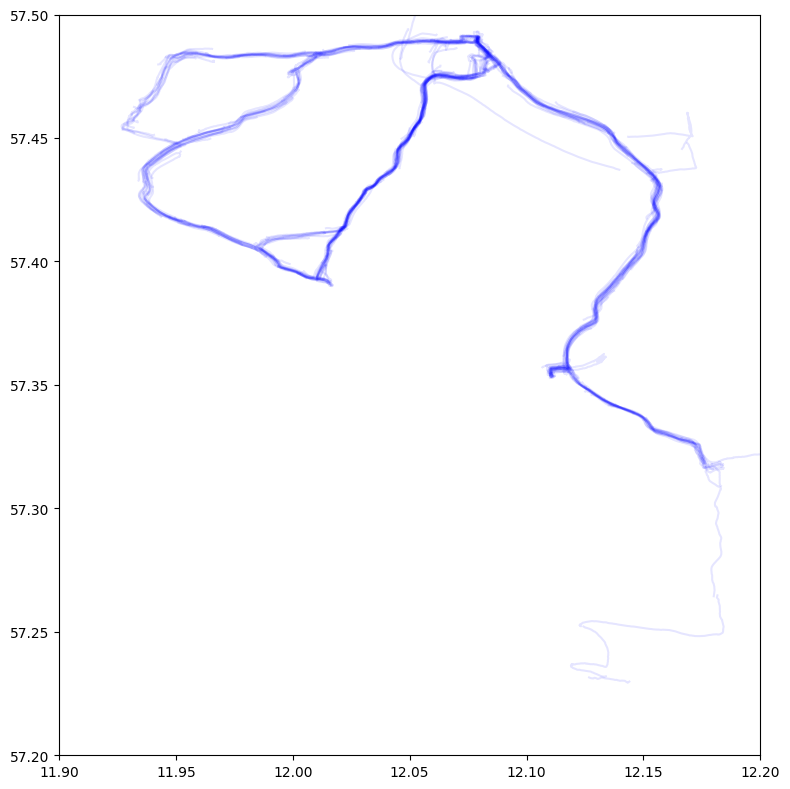

In [110]:
def plot_traj(gen_traj):
    fig = plt.figure(figsize=(8,8))
    for traj in gen_traj:
        y,x,*_ = zip(*traj.to_numpy())
        plt.plot(x,y,color='blue',alpha=0.1)
    
    ax = plt.gca()
    ax.set_xlim([11.9, 12.2]) # static axies or gifs get jumpy
    ax.set_ylim([57.2, 57.5])
    #ax.set_ylim([11.7, 12.5]) # static axies or gifs get jumpy
    #ax.set_xlim([57.0, 57.8])
    plt.tight_layout()
    plt.show()

plot_traj(intermediates[-1])

In [105]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm

def trajectory2PIL(gen_traj):
    fig = plt.figure(figsize=(8,8))
    for traj in gen_traj:
        y,x,*_ = zip(*traj.to_numpy())
        plt.plot(x,y,color='blue',alpha=0.1)
    
    ax = plt.gca()
    ax.set_xlim([11.8, 12.4]) # static axies or gifs get jumpy
    ax.set_ylim([57.1, 57.7])
    plt.tight_layout()
    plt.axis('off')
    
    fig.canvas.draw()
    img = Image.frombytes('RGBA', fig.canvas.get_width_height(), fig.canvas.buffer_rgba())
    plt.close(fig) # Close fig to save RAM
    return img

im = [trajectory2PIL(traj) for traj in tqdm(intermediates)]
# im = [Image.fromarray(np.random.randint(low=0, high=255, size=(300, 300, 3)).astype('uint8')) for _ in range(20)]

im[0].save('steps.gif', save_all=True, append_images=im[1:]+[im[-1]]*5, optimize=False, duration=200, loop=0)

100%|██████████████████████████████████████████| 50/50 [00:21<00:00,  2.31it/s]


## Evaluate data

In [134]:
file_path = Path("eta1_skip5_nsteps500_unet_9900.pickle")
with open(file_path,"rb") as file:
    gen_trajs = pickle.load(file)

gen_t = []
for i,traj in enumerate(gen_trajs):
    df = pd.DataFrame({"lat":traj[:,0],"lon":traj[:,1],"color":i})
    df = add_speed_column(df)
    gen_t.append(df)

In [81]:
def plot_on_map(*dfs, name=None):
    lenghts = [*map(len,dfs)]
    colors = [[i]*l for i, l in enumerate(lengths)]
    fig = px.scatter_mapbox(pd.concat(dfs, axis=0), 
                            lat="lon", 
                            lon="lat", 
                            hover_name="speed", 
                            color=colors, 
                            height=600)
    fig.update_layout(mapbox_style="open-street-map")
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()
    if name:
        plt.savefig(name+'.png');

def plot_on_map(*dfs, name=None):
    import plotly.express as px
    dfs = [df.assign(trip=[i]*len(df)) for i, df in enumerate(dfs)]
    df = pd.concat(dfs, axis=0)
    fig = px.line_map(df, lat='lat', lon='lon', color='trip', hover_data='speed', zoom=12, height=600)
    fig.update_layout(map_style='open-street-map', margin={v:0 for v in 'rtlb'}, showlegend=False)
    if name:
        plt.savefig(name+'.png');
    fig.show();

def hist(*dfs:'DataFrames', name:str='histograms.png', bins:int=30, q:float=.999) -> None:
    'Plots histograms for all intersecting columns of a set of dataframes. q sets the fraction of data to include'
    import matplotlib.pyplot as plt
    cols = set.intersection(*map(lambda x:set(x.columns), dfs))
    length = min(map(lambda x:len(x), dfs))
    fig, axes = plt.subplots(len(dfs), len(cols), figsize=(3*len(cols), 3*len(dfs)))
    if not hasattr(axes[0], '__len__'):
        axes = [axes]

    y_labels = ['Count (original)', 'Count (generated)']
    for ax, label in zip(axes, y_labels):
        ax[0].set_ylabel(label)

    
    for ax, col in zip(axes[0],cols):
        ax.set_title(col)

    # TODO sample max and min from all sets and chain axes
    hard_coded_axies = [[11.8, 12.3], [57.2, 57.8] ,[0,40], [-10,70]]
    for ax0, ax1, lim in zip(axes[0], axes[1], hard_coded_axies):
        ax0.set_xlim(lim)
        ax1.set_xlim(lim)

    #hard_coded_bins = [(bin[1]-bin[0])*(np.arange(0, bins+1))/bins + bin[0] for bin in hard_coded_bins]
    #print(hard_coded_bins)
    for axe, df in zip(axes, dfs):
        for ax, col, bin in zip(axe,cols,hard_coded_axies):
            d = df.iloc[:length][col]
            d = d[d<d.quantile(q=q)]
            #p,b = np.histogram(d, density=True, bins=bin)
            #ax.bar(x=b[1:-2], height=p[1:-1], width=bins, align='edge')
            ax.hist(d, bins=bins, range=bin);
        
    plt.tight_layout()
    if name:
        plt.savefig(name, bbox_inches='tight', pad_inches=0)
    plt.show();

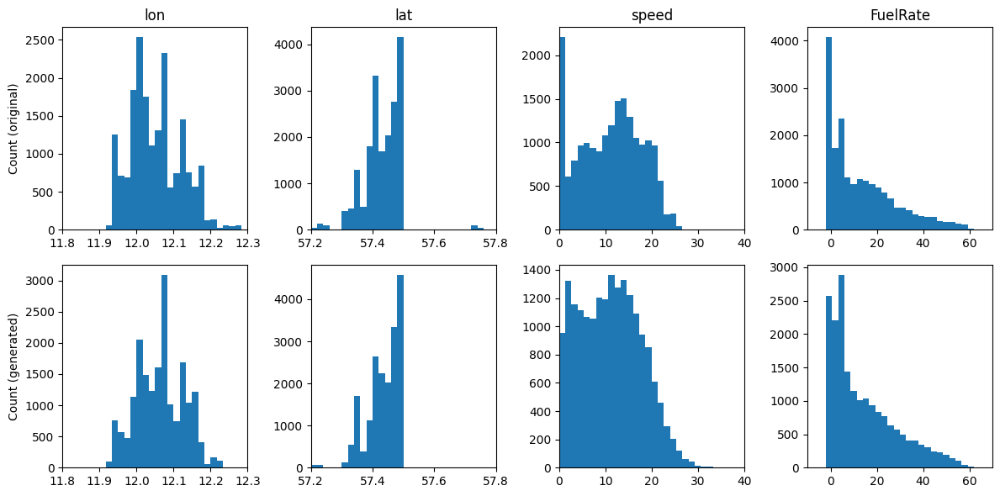

In [109]:
hist(pd.concat(trips, axis=0), pd.concat(gen_traj, axis=0), q=1.0)

In [108]:
plot_on_map(*gen_traj[:100])

In [14]:
with open('og_traj.pickle', 'wb') as file:
    pickle.dump([t[['lat','lon']].to_numpy() for t in og_traj], file)

In [147]:
dummy = pd.DataFrame({
    "lat": [],
    "lon": [],
})
herp = [{"lat":57.486312,"lon":12.077966},{"lat":57.486865,"lon":12.075761},{"lat":57.487457,"lon":12.075643},{"lat":57.487612,"lon":12.076399},{"lat":57.487474,"lon":12.076855},{"lat":57.487249,"lon":12.077472},{"lat":57.487082,"lon":12.078524}]
dummy.loc[:,'lat'] = [h['lat'] for h in herp]
dummy.loc[:,'lon'] = [h['lon'] for h in herp]
add_speed_column(dummy)
dummy

float64 lat    float64
lon    float64
dtype: object


,lat,lon,speed
0,57.486312,12.077966,0.000000
1,57.486865,12.075761,72.713055
2,57.487457,12.075643,33.102094
3,57.487612,12.076399,24.179173
4,57.487474,12.076855,15.638057
5,57.487249,12.077472,22.280852
6,57.487082,12.078524,32.779408
